In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os 
import subprocess
import sys
import random
import gc

# pickle
import pickle

from src.hVOS.cell import Cell
from src.hVOS.morphology import Morphology
from src.hVOS.hvos_readout import hVOSReadout
from src.hVOS.vsd_readout import VSDReadout
from src.hVOS.camera import Camera
from src.hVOS.psf import PSF
from src.hVOS.mcPSF import mcPSF

c:\Users\jjudge3\Desktop\scratch\S1_Thal_NetPyNE_Frontiers_2022\src\hVOS\microscPSF.py:214: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  C, residuals, _, _ = numpy.linalg.lstsq(J.T, phase.T)


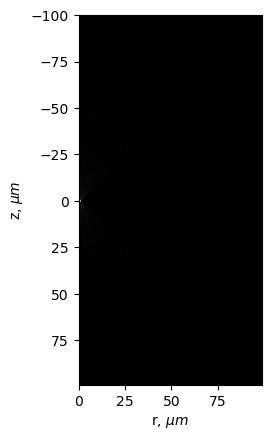

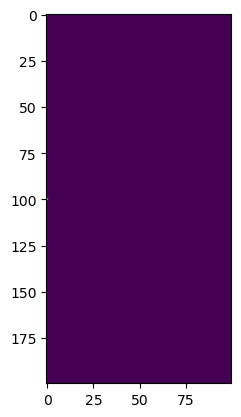

C:\Users\jjudge3\AppData\Local\Temp\ipykernel_6568\4116977209.py:10: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(np.log10(mc_psf), cmap='hot')


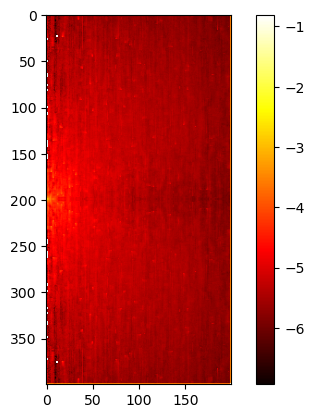

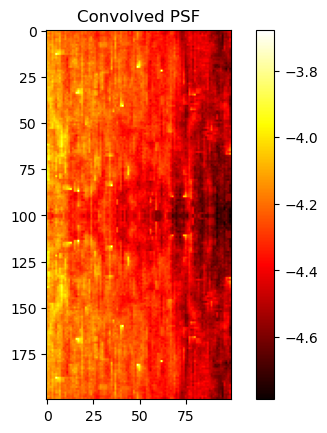

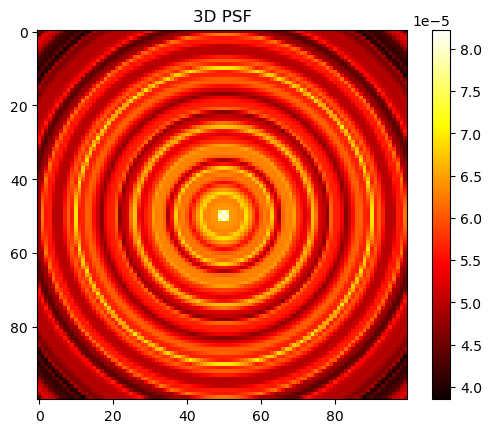

In [2]:
psf = PSF(
    radial_lim=(0, 100.0),  # radial limits, keep < image width 
    axial_lim=(-100.0, 100.0),  # axial limits
)
rad_psf = psf.get_radial_psf()  # returns a 3D PSF, but shows the radial-axial profile
plt.imshow(rad_psf)  # show the radial profile
plt.show()

mc_psf = mcPSF().get_mc_psf()
plt.imshow(np.log10(mc_psf), cmap='hot')
plt.colorbar()
plt.show()

# compose PSFs via convolution
psf.convolve_radial_psf(mc_psf)
plt.imshow(np.log10(psf.get_radial_psf()), cmap='hot')
plt.colorbar()
plt.title('Convolved PSF')
plt.show()

# build 3D PSF and show a sliced radial profile
psf = psf.build_3D_PSF()
plt.imshow(psf[:, :, 0], cmap='hot')
plt.colorbar()
plt.title('3D PSF')
plt.show()

In [3]:
run_id = 1
target_hVOS_populations = ["L4_SS", "L4_PC"]
target_sparsity = 0.6
optical_type = "hVOS"
data_dir = 'C:/Users/jjudge3/Desktop/neuron docker/' # /path/to/compressed/data
model_rec_out_dir = data_dir + 'archive/run' + str(run_id) + "/model_rec/" # /path/to/NMC/cellNMLfiles
morphology_data_dir = 'C:/Users/jjudge3/Desktop/scratch/NMC_model/NMC.NeuronML2/' # /path/to/NMC/cellNMLfiles
overwrite_optical_data = False

In [4]:
compart_data = {}
target_dir = data_dir + 'archive/run' + str(run_id) + "/"
for file in os.listdir(data_dir):
    if file.endswith('.tar.gz'):
        compart = file.replace('.tar.gz', "").replace('S1-Thal-output-',"")
        output_dir = target_dir + compart + '/'
        compart_data[compart] = output_dir

me_type_map_file = 'C:/Users/jjudge3/Desktop/neuron docker/' + 'archive/run' + str(run_id) + "/" + 'cell_id_to_me_type_map.pkl'
loaded_compart_data = {}
if os.path.exists(me_type_map_file):
    with open(me_type_map_file, 'rb') as f:
        cell_id_to_me_type_map = pickle.load(f)


for compart in compart_data.keys(): 
    target_dir = data_dir + 'archive/run' + str(run_id) + '/' + compart
    if not os.path.exists(target_dir):
        print('Directory ' + target_dir + ' does not exist')
        continue
    target_dir += '/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/'
    for file in os.listdir(target_dir):
        if file.endswith('.dat') and 'v7_batch1_0_0' in file and 'cell' in file:
            file_name = file.replace(".dat", "").replace("v7_batch1_0_0_", "").split('_')
            compart = "_".join(file_name[:2])
            cell_id = "_".join(file_name[2:])
            if 'soma' in file:
                compart = 'Vsoma'
                cell_id = 'cell_' + cell_id
                
            if compart not in loaded_compart_data:
                loaded_compart_data[compart] = {}
            if cell_id not in loaded_compart_data[compart]:
                loaded_compart_data[compart][cell_id] = {}
            loaded_compart_data[compart][cell_id] = target_dir + file

# load time
target_dir = data_dir + 'archive/run' + str(run_id) + '/'
mm_time_fp = target_dir + 'v7_batch1_0_0_time.dat'
loaded_compart_data['time'] = np.memmap(mm_time_fp, dtype='float32', mode='r')

loaded_compart_data

{'Vapic_0': {'cell_11014': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11014.dat',
  'cell_11015': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11015.dat',
  'cell_11016': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11016.dat',
  'cell_11017': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11017.dat',
  'cell_11018': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11018.dat',
  'cell_11019': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11019.dat',
  'ce

In [5]:
# for each soma, get a cell id and aggregate its axons, apics, dends
cells = {}
me_type_morphology_map = {}
for cell_id in loaded_compart_data['Vsoma']:
    soma = loaded_compart_data['Vsoma'][cell_id]
    axons = {}
    apics = {}
    dends = {}
    for compart in loaded_compart_data.keys():
        if compart == 'time':
            continue
        if cell_id in loaded_compart_data[compart]:
            if 'axon' in compart:
                axons[compart] = loaded_compart_data[compart][cell_id]
            elif 'apic' in compart:
                apics[compart] = loaded_compart_data[compart][cell_id]
            elif 'dend' in compart:
                dends[compart] = loaded_compart_data[compart][cell_id]

    short_cell_id = int(cell_id.replace('cell_', ''))
    me_type = cell_id_to_me_type_map[short_cell_id]['me_type']
    x = cell_id_to_me_type_map[short_cell_id]['x']
    y = cell_id_to_me_type_map[short_cell_id]['y']
    z = cell_id_to_me_type_map[short_cell_id]['z']
    cells[cell_id] = Cell(cell_id, me_type, axons, apics, dends, soma, x, y, z, optical_filelabel=optical_type)

    if me_type not in me_type_morphology_map:
        # load morphology
        # find files in morphology_data_dir with me_type in the name
        m_type, e_type = me_type[:6], me_type[7:]
        me_type_files = [f for f in os.listdir(morphology_data_dir) if (m_type in f and e_type in f and f.endswith('.cell.nml'))]
        if len(me_type_files) == 0:
            assert me_type not in target_hVOS_populations  # we only care if we cannot load a target population
        
        # load all morphology file matches
        me_type_morphology_map[me_type] = [Morphology(me_type, morphology_data_dir + me_type_file) for me_type_file in me_type_files]

me_type_morphology_map

{'L1_DAC_bNA': [Morphology(me_type=L1_DAC_bNA),
  Morphology(me_type=L1_DAC_bNA),
  Morphology(me_type=L1_DAC_bNA),
  Morphology(me_type=L1_DAC_bNA),
  Morphology(me_type=L1_DAC_bNA)],
 'L1_HAC_cIR': [Morphology(me_type=L1_HAC_cIR),
  Morphology(me_type=L1_HAC_cIR),
  Morphology(me_type=L1_HAC_cIR),
  Morphology(me_type=L1_HAC_cIR),
  Morphology(me_type=L1_HAC_cIR)],
 'L4_SBC_bNA': [Morphology(me_type=L4_SBC_bNA),
  Morphology(me_type=L4_SBC_bNA),
  Morphology(me_type=L4_SBC_bNA),
  Morphology(me_type=L4_SBC_bNA),
  Morphology(me_type=L4_SBC_bNA)],
 'L4_SBC_cAC': [Morphology(me_type=L4_SBC_cAC),
  Morphology(me_type=L4_SBC_cAC),
  Morphology(me_type=L4_SBC_cAC),
  Morphology(me_type=L4_SBC_cAC),
  Morphology(me_type=L4_SBC_cAC)],
 'L4_SBC_dNA': [Morphology(me_type=L4_SBC_dNA),
  Morphology(me_type=L4_SBC_dNA),
  Morphology(me_type=L4_SBC_dNA),
  Morphology(me_type=L4_SBC_dNA),
  Morphology(me_type=L4_SBC_dNA)],
 'L4_SP_cAD': [Morphology(me_type=L4_SP_cAD),
  Morphology(me_type=L4_SP_cA

Computing optical signal for cell_12112
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12113
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12114
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12115
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12116
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12117
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12118
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12119
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12120
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12121
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12122
	Finished 

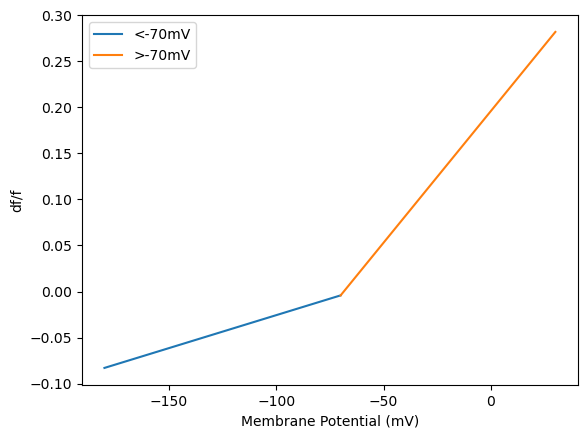

In [6]:
# cells dict maps cell_id to Cell object
# me_type_morphology_map maps me_type to list of Morphology objects
# target populations is a list of me_types to compute signal for
target_population_cells = [
    cells[cell_id] for cell_id in cells 
        if any([t_pop in cells[cell_id].get_me_type() for 
                    t_pop in target_hVOS_populations ]) 
]
 # sparsity sampling implemented here
target_population_cells = [cell for cell in target_population_cells
                                if random.random() < target_sparsity]
optical_readout = {'hVOS': hVOSReadout, 'VSD': VSDReadout}[optical_type]
hvos_readout = optical_readout(target_hVOS_populations, 
                               cells, 
                               me_type_morphology_map,
                               force_overwrite=overwrite_optical_data)
target_dir = data_dir + 'archive/run' + str(run_id) + '/'
hvos_readout.compute_optical_signal(target_dir)
hvos_readout.show_voltage_to_intensity_curve()

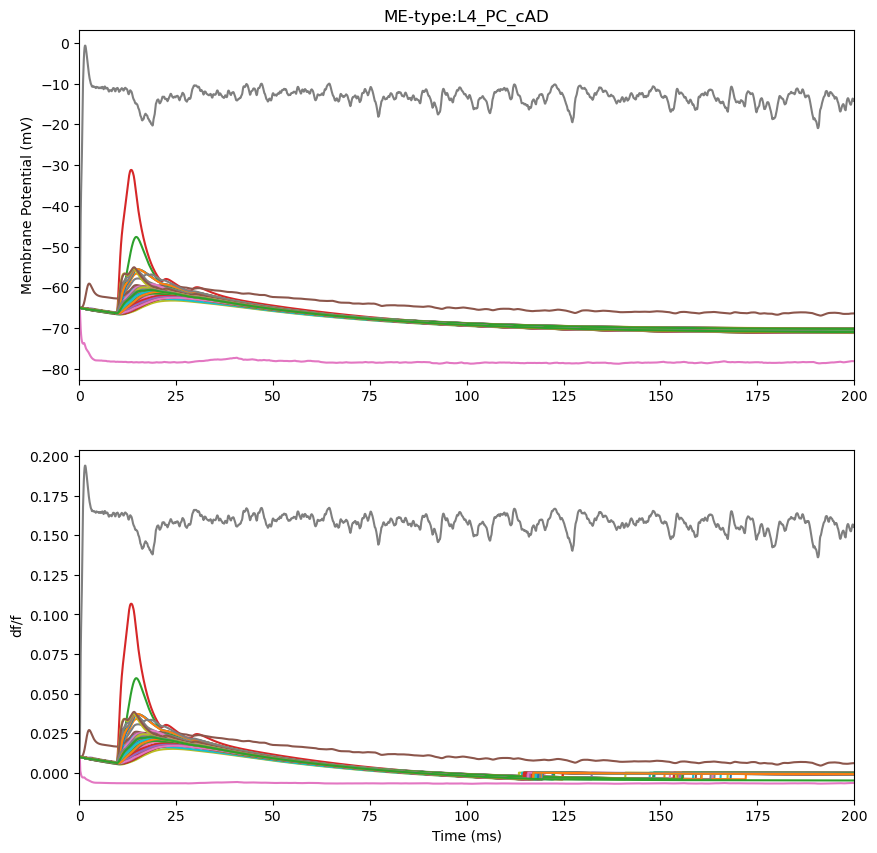

In [7]:
# plot signal, choose random cell

cell = random.choice(target_population_cells)
compart_ids = cell.get_list_compartment_ids()
# make two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 10))
for compart_id in compart_ids:
    voltage_trace = cell.get_voltage_trace(compart_id)
    intensity_trace = cell.get_optical_trace(compart_id)
    axs[0].plot(loaded_compart_data['time'],voltage_trace, label='Voltage')
    axs[1].plot(loaded_compart_data['time'],intensity_trace, label='Intensity')
axs[1].set_xlabel('Time (ms)')
axs[0].set_ylabel('Membrane Potential (mV)')
axs[1].set_ylabel('df/f')
for ax in axs:
    ax.set_xlim(0, 200)

axs[0].set_title('ME-type:' + cell.get_me_type())

plt.show()

#
#hvos_readout.plot_optical_signal(cell_id)

In [8]:
# determine which morphology to use for each cell
for morph_key in me_type_morphology_map:
    for morph in me_type_morphology_map[morph_key]:
        for cell in target_population_cells:
            if cell.get_me_type() == morph.me_type:

                if morph.does_cell_match_morphology(cell):
                    cell.set_morphology(morph)

print("Any target cells missing structure data?:", 
      any([cell.get_morphology() == None 
           for cell in target_population_cells]))

Any target cells missing structure data?: False


In [9]:
cell = target_population_cells[103]  #random.choice(target_population_cells)
soma_position = cell.get_soma_position()

In [ ]:
cam_width = 1000
cam_height = 1000
cam = Camera([cell], 
             me_type_morphology_map, 
             loaded_compart_data['time'],
             fov_center=soma_position,
             camera_resolution=1.0,
             camera_width=cam_width,
             camera_height=cam_height,
             psf=psf,
             data_dir=model_rec_out_dir, # + 'tmp/', #, #
             use_2d_psf=False)
cam._draw_cell(cell)


Drawing Cell(id=cell_8407, me_type=L4_PC_cAD, position=345.62022619392343, 805.0505906240525, 171.90457169353712)


In [ ]:
t = loaded_compart_data['time']
time_step_size = t[1] - t[0]

for compart_id in ['soma', 'axon', 'apic', 'dend']:
    for activity_type in ['synaptic', 'spiking']:
        rec = cam.get_cell_recording().get_raw_recording(compart_id=compart_id, 
                                                         activity_type=activity_type)
        cam.animate_frames_to_video(rec, 
                        frames=(0,500),
                        filename='w_psf_' + compart_id + "_" + activity_type + '.gif',
                        time_step_size=time_step_size,
                        vmin=0,
                        vmax=0.001)
cam.close_memmaps()

{'soma': {}, 'axon': {}, 'dend': {}, 'apic': {}}


KeyError: 'synaptic'

In [ ]:
cam_no_psf = Camera(target_population_cells, 
             me_type_morphology_map, 
             loaded_compart_data['time'],
             fov_center=soma_position,
             camera_resolution=1.0,
             camera_width=cam_width,
             camera_height=cam_height,
             psf=None,
             data_dir=model_rec_out_dir + 'tmp/',#, #
             use_2d_psf=True)
cam_no_psf._draw_cell(cell)
for compart_id in ['soma', 'axon', 'apic', 'dend']:
    for activity_type in ['synaptic', 'spiking']:
        rec = cam_no_psf.get_cell_recording().get_raw_recording(compart_id=compart_id, 
                                                         activity_type=activity_type)
        cam_no_psf.animate_frames_to_video(rec, 
                        frames=(0,500),
                        filename='no_psf_' + compart_id + "_" + activity_type + '.gif',
                        time_step_size=time_step_size)
cam_no_psf.close_memmaps()

Drawing Cell(id=cell_8420, me_type=L4_PC_cAD, position=271.52179675523877, 679.5940333733349, 340.70462992412706)


KeyboardInterrupt: 

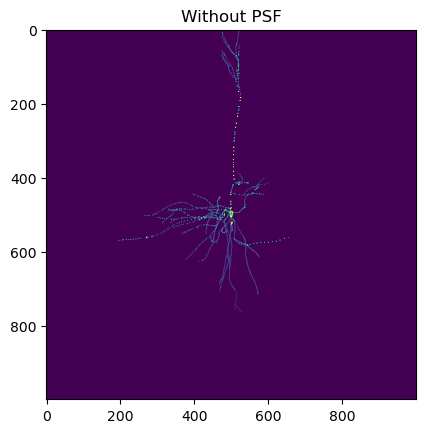